In [239]:
from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation, Flatten
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,TimeDistributed,RepeatVector,Merge
from keras.preprocessing.text import one_hot
from keras.preprocessing import sequence
import numpy as np

from keras.models import Sequential,Model
from keras.layers.core import Dense, Dropout, Activation, Flatten, MaxoutDense
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,TimeDistributed,RepeatVector,Merge,Input,merge,UpSampling2D

from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
from numpy.random import random, permutation, randn, normal 
import PIL.Image
import os
import json
from tqdm import tqdm



from keras.optimizers import SGD, RMSprop, Adam

import cPickle as pickle
from matplotlib import pyplot as plt

from itertools import compress

import shutil
import string

import collections
import nltk
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import stopwords

import bcolz
import cPickle as pickle

from random import shuffle

import cv2

In [2]:
def load_array(fname):
    return bcolz.open(fname)[:]

def load_obj(path):
    with open(path, 'rb') as f:
        return pickle.load(f)

In [4]:
raw_data = np.asarray(load_obj("full_CNN_train.p"))
raw_labels = np.asarray(load_obj("full_CNN_labels.p"))

print(raw_data.shape)
print(raw_labels.shape)

(12764, 80, 160, 3)
(12764, 80, 160, 1)


In [13]:
img_height = raw_data.shape[1]

new_img_height = 40

data = raw_data[:,new_img_height:,...]
labels = raw_labels[:,new_img_height:,...]

print(data.shape)
print(labels.shape)

(12764, 40, 160, 3)
(12764, 40, 160, 1)


/opt/conda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


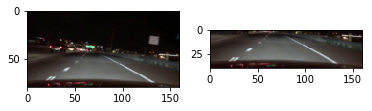

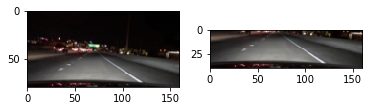

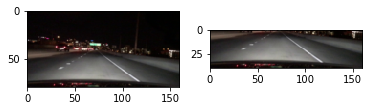

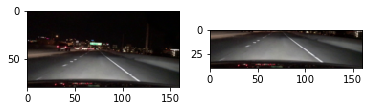

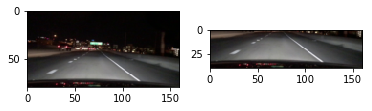

...

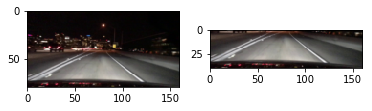

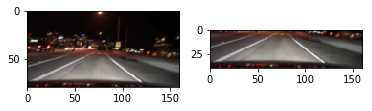

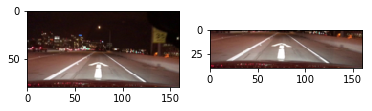

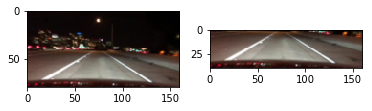

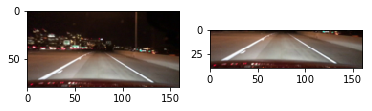

In [8]:
for i in range(30):

    plt.subplot(1,2,1)
    plt.imshow(raw_data[i])

    plt.subplot(1,2,2)
    plt.imshow(data[i])
    
    plt.figure()

plt.show()

In [9]:
new_size = 224

In [14]:
data =  np.stack([np.asarray(PIL.Image.fromarray(current_data).resize((new_size, new_size), PIL.Image.NEAREST)) 
                        for current_data in tqdm(data)])



labels = np.stack([np.asarray(PIL.Image.fromarray(np.concatenate([current_data,current_data,current_data],axis=2)).resize((new_size, new_size), PIL.Image.NEAREST)) 
                         for current_data in tqdm(labels)])[...,:1]

print(data.shape)
print(labels.shape)

100%|██████████| 12764/12764 [00:02<00:00, 4849.12it/s]


(12764, 224, 224, 3)
(12764, 224, 224, 1)


In [15]:
data2labels = zip(data,labels)
shuffle(data2labels)

data = [data for data,_ in data2labels]
labels = [label for _,label in data2labels]

data = np.stack(data)
labels = np.stack(labels)

print(data.shape)
print(labels.shape)

(12764, 224, 224, 3)
(12764, 224, 224, 1)


In [36]:
threshold = 10000

train_data = data[:threshold]
train_labels = labels[:threshold]

test_data = data[threshold:]
test_labels = labels[threshold:] 

In [38]:
print(train_data.shape)
print(train_labels.shape)

print(test_data.shape)
print(test_labels.shape)

(10000, 224, 224, 3)
(10000, 224, 224, 1)
(2764, 224, 224, 3)
(2764, 224, 224, 1)


## Plot

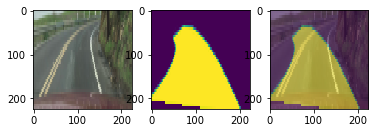

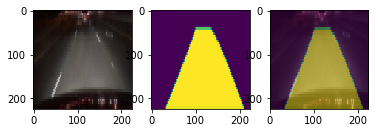

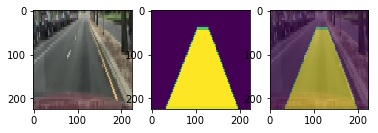

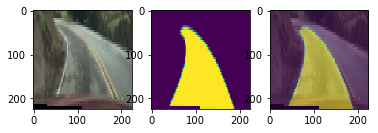

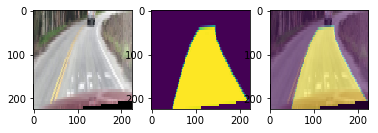

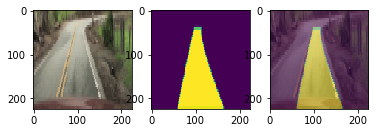

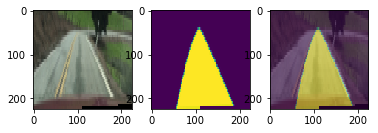

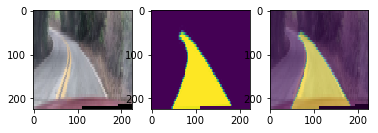

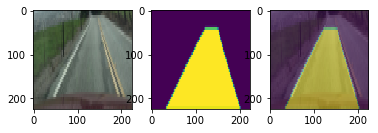

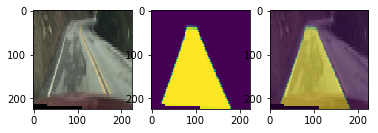

In [40]:
for i in range(10):

    current_data = train_data[-i]
    current_label = np.squeeze(train_labels[-i])
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_label)

    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_label, alpha=0.5)
        
    plt.figure()

plt.show()

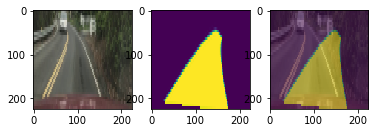

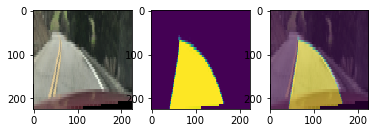

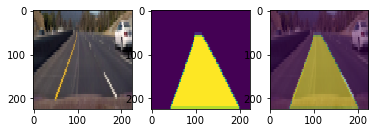

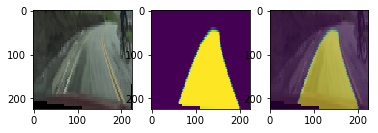

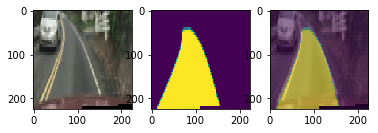

...

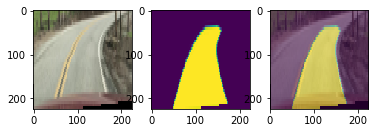

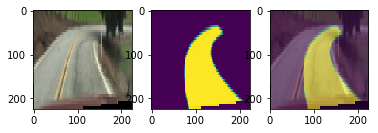

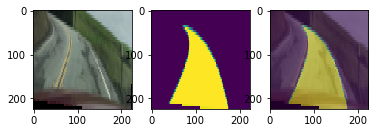

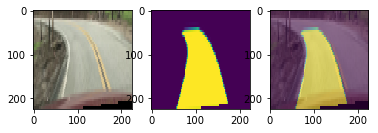

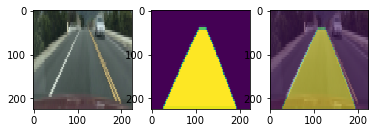

In [42]:
for i in range(50):

    current_data = test_data[-i]
    current_label = np.squeeze(test_labels[-i])
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_label)

    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_label, alpha=0.5)
        
    plt.figure()

plt.show()

## Train

In [18]:
def get_unet(img_rows, img_cols):
    
    inputs = Input((3, img_rows, img_cols))
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(inputs)
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(pool1)
    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(pool2)
    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(pool3)
    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(pool4)
    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(conv5)

    up6 = merge([UpSampling2D(size=(2, 2))(conv5), conv4], mode='concat', concat_axis=1)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(up6)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv6)

    up7 = merge([UpSampling2D(size=(2, 2))(conv6), conv3], mode='concat', concat_axis=1)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(up7)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv7)

    up8 = merge([UpSampling2D(size=(2, 2))(conv7), conv2], mode='concat', concat_axis=1)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(up8)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv8)

    up9 = merge([UpSampling2D(size=(2, 2))(conv8), conv1], mode='concat', concat_axis=1)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(up9)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv9)

    conv10 = Convolution2D(1, 1, 1, activation='sigmoid')(conv9)

    model = Model(input=inputs, output=conv10)

    model.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy')
#     model.compile(optimizer=Adam(lr=1e-5),loss='categorical_crossentropy')
    return model

In [19]:
model = get_unet(new_size,new_size)
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 3, 224, 224)   0                                            
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 32, 224, 224)  896         input_1[0][0]                    
____________________________________________________________________________________________________
convolution2d_2 (Convolution2D)  (None, 32, 224, 224)  9248        convolution2d_1[0][0]            
____________________________________________________________________________________________________
maxpooling2d_1 (MaxPooling2D)    (None, 32, 112, 112)  0           convolution2d_2[0][0]            
___________________________________________________________________________________________

In [20]:
train_data_format = np.transpose(train_data,(0,3,1,2))
train_labels_format = np.transpose(train_labels,(0,3,1,2))

test_data_format = np.transpose(test_data,(0,3,1,2))
test_labels_format = np.transpose(test_labels,(0,3,1,2))

print(train_data_format.shape)
print(train_labels_format.shape)

(10000, 3, 224, 224)
(10000, 1, 224, 224)


In [21]:
model.fit(train_data_format, 
          train_labels_format, 
          batch_size=32, 
          nb_epoch=2
         )

Epoch 1/2
10000/10000 [==============================] - 468s - loss: 84052.4928     

In [23]:
model.save_weights("unet-224-2e.h5")

In [26]:
# to_predict_data = train_data_format[:150]
to_predict_data = test_data_format[:150]

np.random.shuffle(to_predict_data)

preds = model.predict(to_predict_data)
preds.shape


(150, 1, 224, 224)

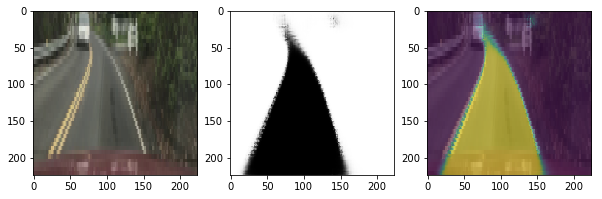

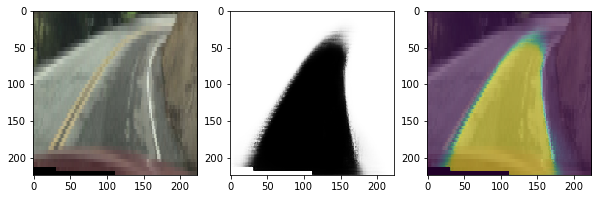

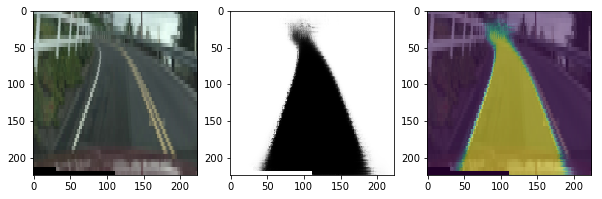

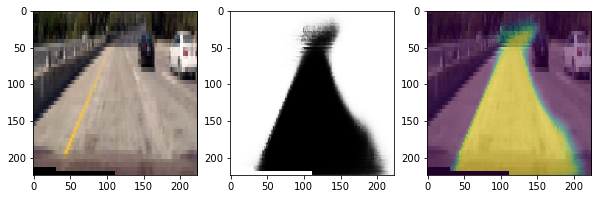

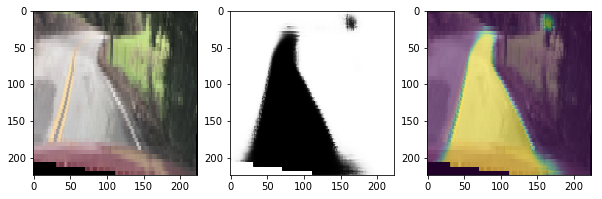

...

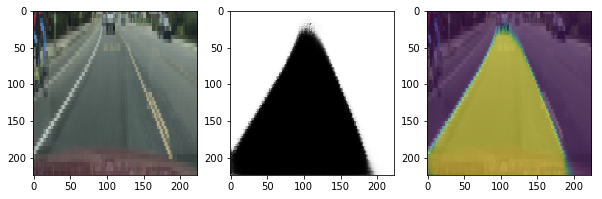

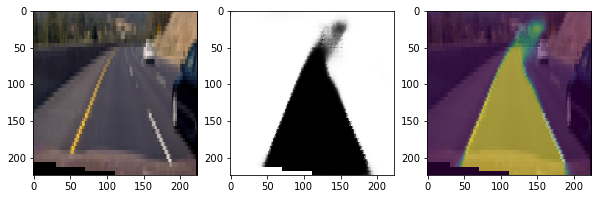

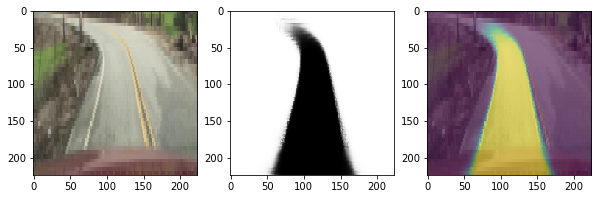

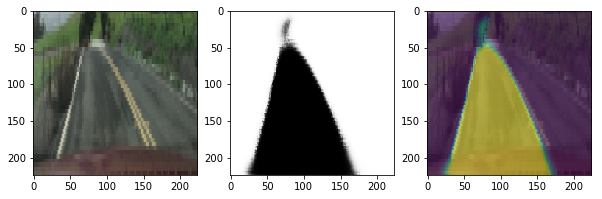

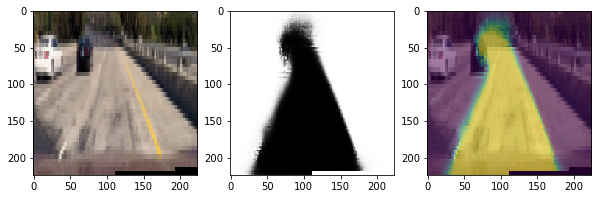

In [43]:
fig_size= 10

for i in range(100):

    plt.figure(figsize=(fig_size,fig_size))
    
    current_data = np.transpose(to_predict_data[i],(1,2,0))
    current_pred = np.squeeze(preds[i])
    
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_pred, cmap='Greys')
    
    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_pred, alpha=0.5)

    plt.figure(figsize=(fig_size,fig_size))

plt.show()

## OSC

In [145]:
osc_paths = [str(i)+".jpg" for i in range(0,1000)]

In [146]:
osc_paths[:10]

['0.jpg',
 '1.jpg',
 '2.jpg',
 '3.jpg',
 '4.jpg',
 '5.jpg',
 '6.jpg',
 '7.jpg',
 '8.jpg',
 '9.jpg']

In [147]:
raw_osc_images = [np.asarray(PIL.Image.open("./4883/"+img_path)) for img_path in tqdm(osc_paths[:100])]
raw_osc_images = np.stack(raw_osc_images)
raw_osc_images.shape

100%|██████████| 100/100 [00:01<00:00, 69.68it/s]


(100, 960, 1280, 3)

In [148]:
new_img_height = 640
osc_images = raw_osc_images[:,new_img_height:,...]
print(osc_images.shape)

(100, 320, 1280, 3)


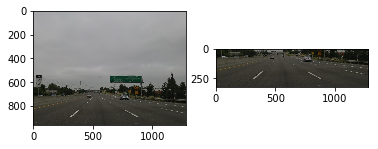

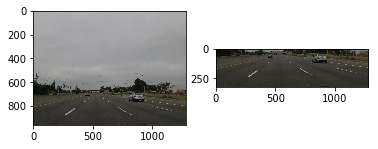

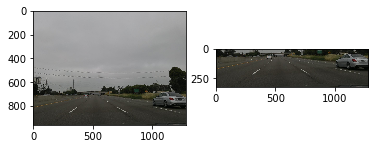

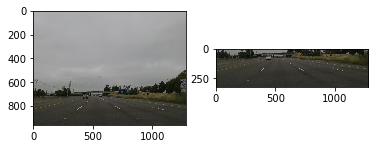

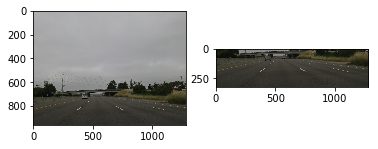

...

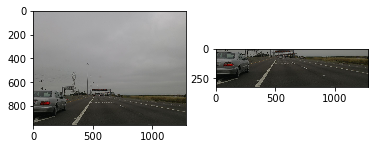

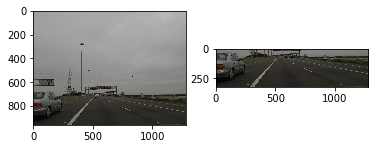

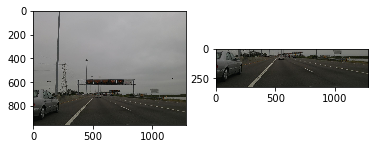

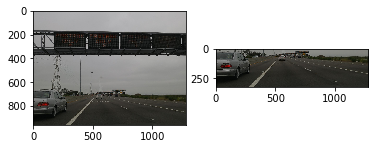

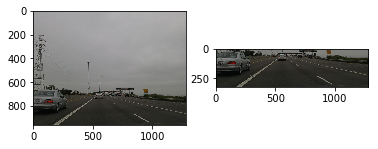

In [149]:
for i in range(50):

    raw_data = raw_osc_images[i]
    osc_data = osc_images[i]
    
    plt.subplot(1,2,1)
    plt.imshow(raw_data)

    plt.subplot(1,2,2)
    plt.imshow(osc_data)
    
    plt.figure()

plt.show()

In [150]:
new_size = 224

resized_osc_images =  np.stack([np.asarray(PIL.Image.fromarray(current_data).resize((new_size, new_size), PIL.Image.NEAREST)) 
                        for current_data in tqdm(osc_images)])

resized_osc_images.shape

100%|██████████| 100/100 [00:00<00:00, 889.02it/s]


(100, 224, 224, 3)

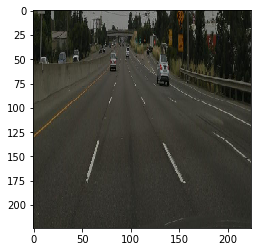

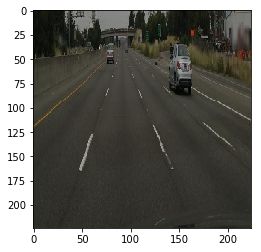

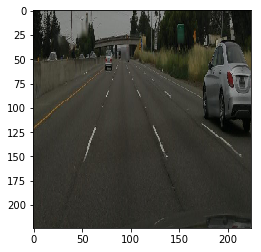

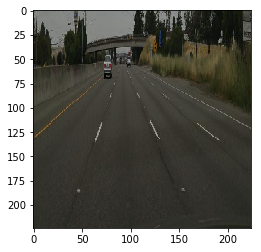

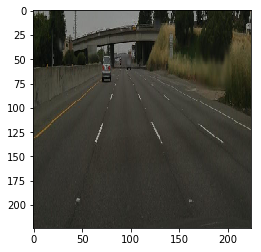

...

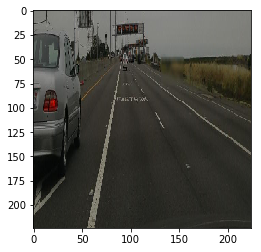

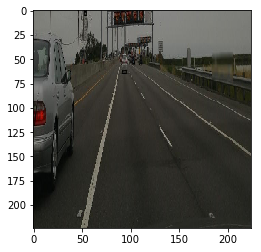

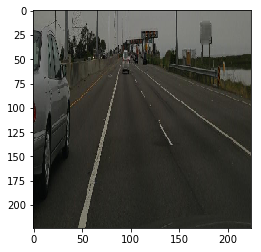

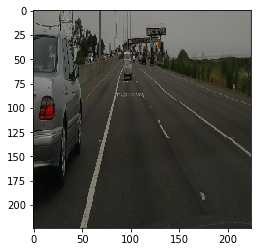

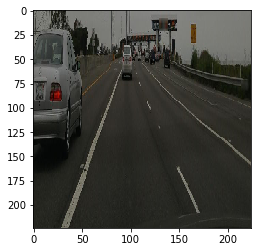

In [151]:
for i in range(50):

    current_data = resized_osc_images[i]
    plt.imshow(current_data)
    plt.figure()

plt.show()

In [152]:
osc_images_format = np.transpose(resized_osc_images,(0,3,1,2))
osc_images_format.shape

(100, 3, 224, 224)

In [153]:
osc_preds = model.predict(osc_images_format)

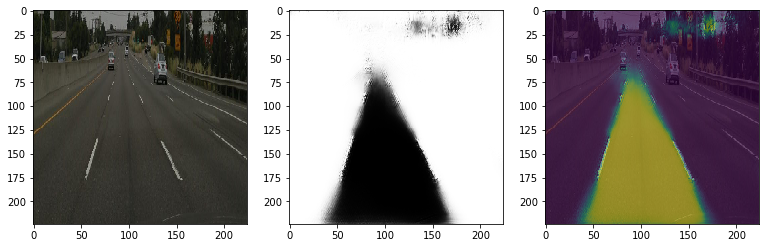

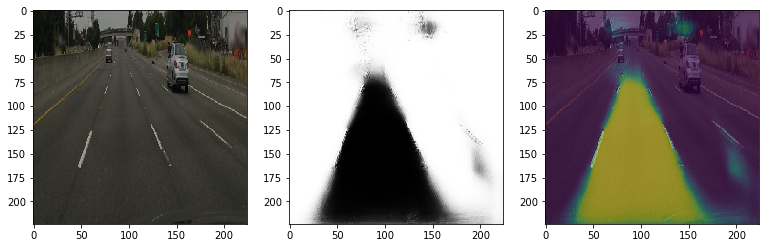

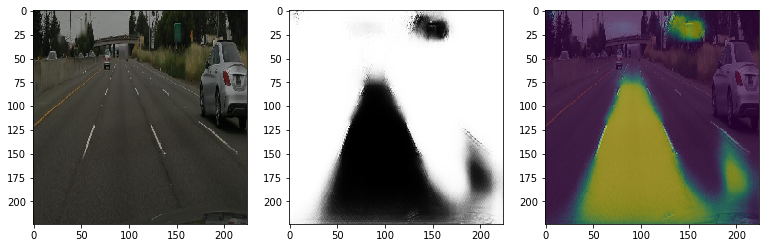

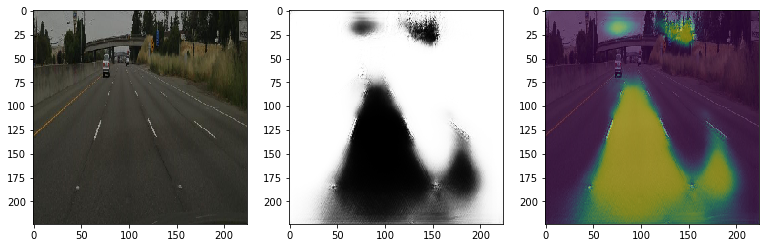

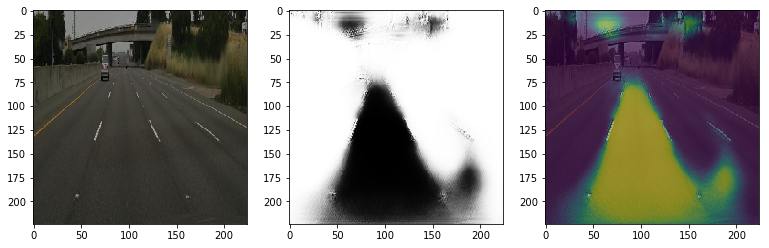

...

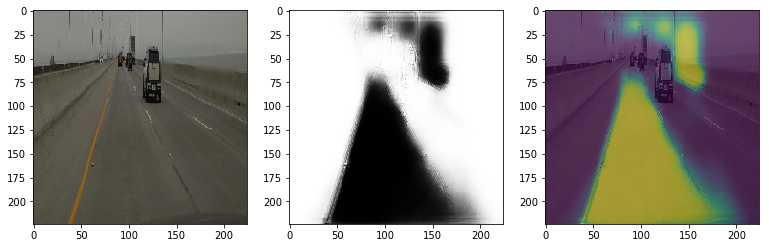

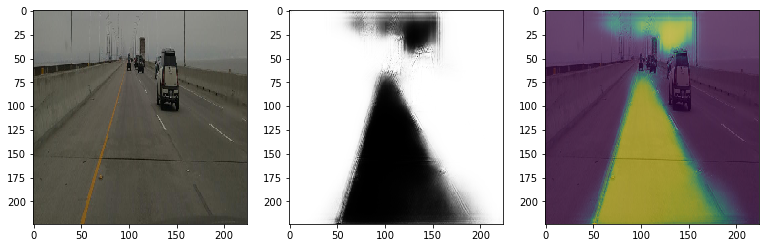

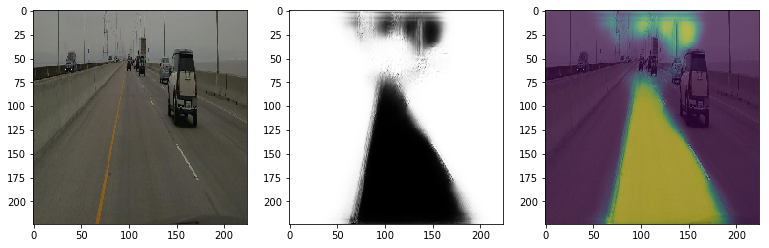

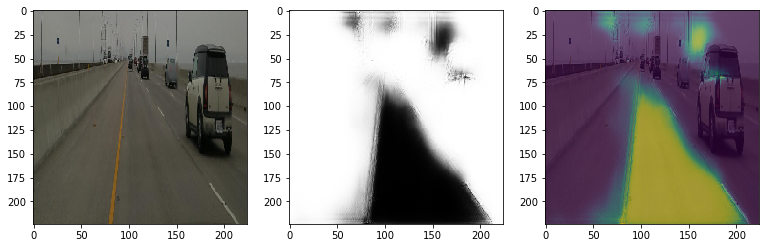

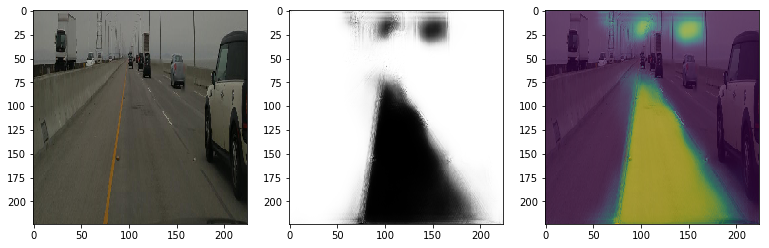

In [246]:
fig_size= 13

for i in range(100):

    plt.figure(figsize=(fig_size,fig_size))
    
    current_data = np.transpose(osc_images_format[i],(1,2,0))
    current_pred = np.squeeze(osc_preds[i])
    
    plt.subplot(1,3,1)
    plt.imshow(current_data)

    plt.subplot(1,3,2)
    plt.imshow(current_pred, cmap='Greys')
    
    plt.subplot(1,3,3)

    plt.imshow(current_data)
    plt.imshow(current_pred, alpha=0.5)

    plt.figure(figsize=(fig_size,fig_size))

plt.show()